In [4]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

In [5]:
def load_dataset(dataset_name, mix=True):
    dataset = np.load(dataset_name, allow_pickle=True)
    X = dataset[()]['x']
    Y = dataset[()]['y']
    if mix:
        x_train, x_test, y_train, y_test = train_test_split(np.array(X), np.array(Y), test_size=0.1, random_state=9)
        return np.array(x_train), np.array(x_test), np.array(y_train), np.array(y_test)
    else:
        return np.array(X), np.array(Y)

In [6]:
Enterface_X, Enterface_Y = load_dataset('Enterface.npy', mix=False)
Meld_X, Meld_Y = load_dataset('Meld.npy', mix=False)
full_X = np.concatenate((Enterface_X, Meld_X), axis=0)
full_Y = np.concatenate((Enterface_Y, Meld_Y), axis=0)

### PCA

In [74]:
pca = PCA(n_components=3)
pca_result_Meld = pca.fit_transform(Meld_X)
pca = PCA(n_components=3)
pca_result_Enterface = pca.fit_transform(Enterface_X)
pca = PCA(n_components=3)
pca_result_full = pca.fit_transform(full_X)

Text(0.5, 1.0, 'full')

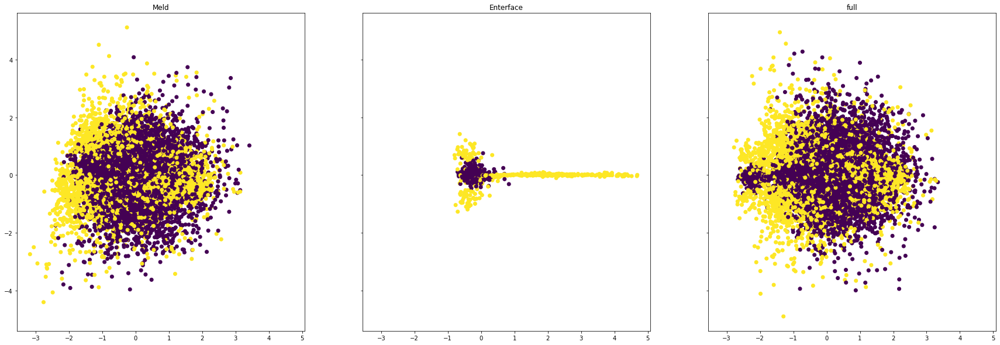

In [80]:
fig, axs = plt.subplots(1, 3, sharex=True, sharey=True, figsize = (30,10))
axs[0].scatter(pca_result_Meld[:,0], pca_result_Meld[:,1], c=Meld_Y)
axs[0].set_title('Meld')
axs[1].scatter(pca_result_Enterface[:,0], pca_result_Enterface[:,1], c=Enterface_Y)
axs[1].set_title('Enterface')
axs[2].scatter(pca_result_full[:,0], pca_result_full[:,1], c=full_Y)
axs[2].set_title('full')

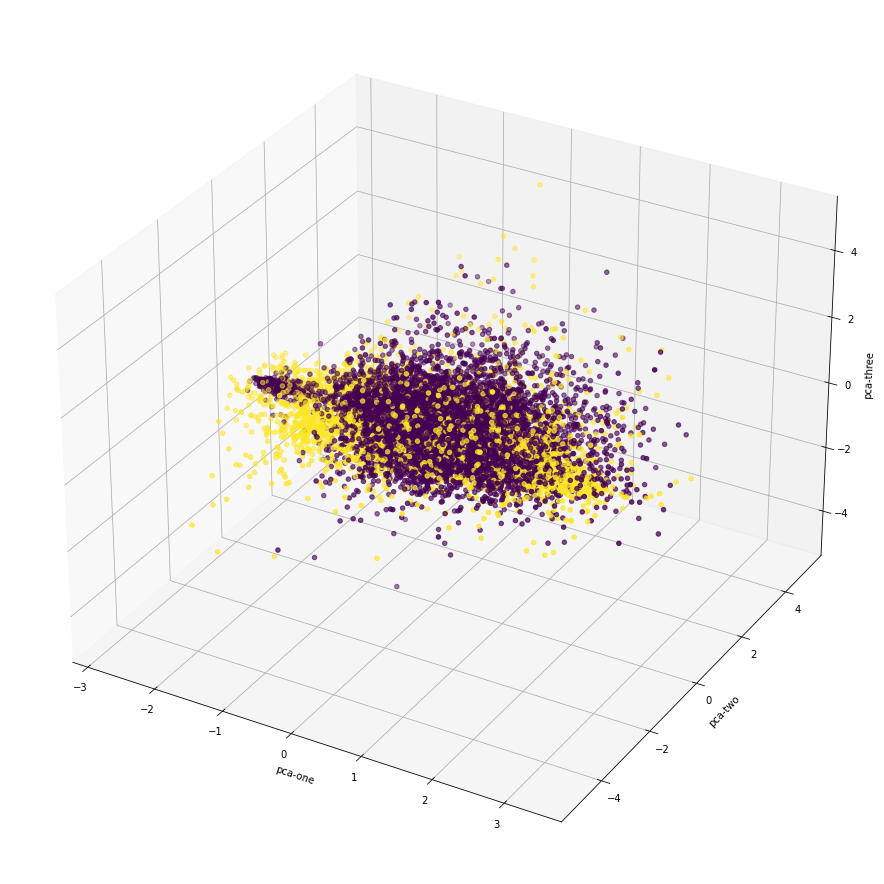

In [70]:
ax = plt.figure(figsize=(20,16)).gca(projection='3d')
ax.scatter(
    xs=pca_result[:,0], 
    ys=pca_result[:,1], 
    zs=pca_result[:,2], 
    c=full_Y, 
)
ax.set_xlabel('pca-one')
ax.set_ylabel('pca-two')
ax.set_zlabel('pca-three')
plt.show()

### TSNE

In [81]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_full = tsne.fit_transform(full_X)
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_Meld = tsne.fit_transform(Meld_X)
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_Enterface = tsne.fit_transform(Enterface_X)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 18208 samples in 0.004s...
[t-SNE] Computed neighbors for 18208 samples in 17.231s...
[t-SNE] Computed conditional probabilities for sample 1000 / 18208
[t-SNE] Computed conditional probabilities for sample 2000 / 18208
[t-SNE] Computed conditional probabilities for sample 3000 / 18208
[t-SNE] Computed conditional probabilities for sample 4000 / 18208
[t-SNE] Computed conditional probabilities for sample 5000 / 18208
[t-SNE] Computed conditional probabilities for sample 6000 / 18208
[t-SNE] Computed conditional probabilities for sample 7000 / 18208
[t-SNE] Computed conditional probabilities for sample 8000 / 18208
[t-SNE] Computed conditional probabilities for sample 9000 / 18208
[t-SNE] Computed conditional probabilities for sample 10000 / 18208
[t-SNE] Computed conditional probabilities for sample 11000 / 18208
[t-SNE] Computed conditional probabilities for sample 12000 / 18208
[t-SNE] Computed conditional probabilities for s

Text(0.5, 1.0, 'full')

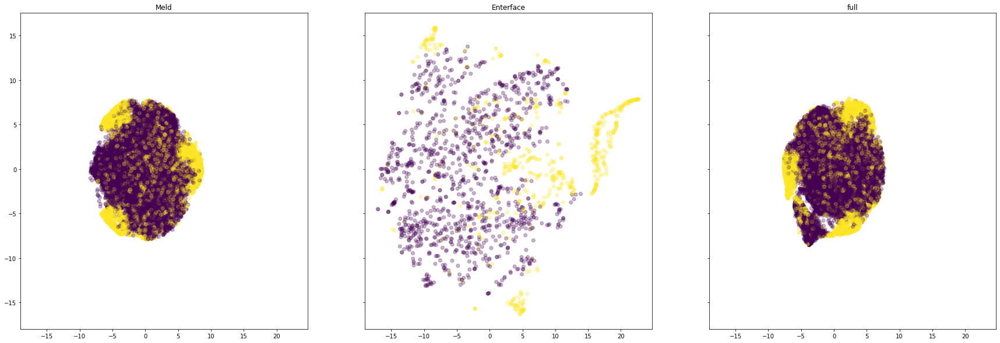

In [88]:
fig, axs = plt.subplots(1, 3, sharex=True, sharey=True, figsize = (30,10))
axs[0].scatter(tsne_results_Meld[:,0], tsne_results_Meld[:,1], c=Meld_Y, alpha=.3)
axs[0].set_title('Meld')
axs[1].scatter(tsne_results_Enterface[:,0], tsne_results_Enterface[:,1], c=Enterface_Y, alpha=.3)
axs[1].set_title('Enterface')
axs[2].scatter(tsne_results_full[:,0], tsne_results_full[:,1], c=full_Y, alpha=.3)
axs[2].set_title('full')


In [89]:
pca = PCA(n_components=50)
pca_result_Meld = pca.fit_transform(Meld_X)
pca = PCA(n_components=50)
pca_result_Enterface = pca.fit_transform(Enterface_X)
pca = PCA(n_components=50)
pca_result_full = pca.fit_transform(full_X)
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_full = tsne.fit_transform(pca_result_full)
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_Meld = tsne.fit_transform(pca_result_Meld)
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_Enterface = tsne.fit_transform(pca_result_Enterface)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 18208 samples in 0.001s...
[t-SNE] Computed neighbors for 18208 samples in 13.533s...
[t-SNE] Computed conditional probabilities for sample 1000 / 18208
[t-SNE] Computed conditional probabilities for sample 2000 / 18208
[t-SNE] Computed conditional probabilities for sample 3000 / 18208
[t-SNE] Computed conditional probabilities for sample 4000 / 18208
[t-SNE] Computed conditional probabilities for sample 5000 / 18208
[t-SNE] Computed conditional probabilities for sample 6000 / 18208
[t-SNE] Computed conditional probabilities for sample 7000 / 18208
[t-SNE] Computed conditional probabilities for sample 8000 / 18208
[t-SNE] Computed conditional probabilities for sample 9000 / 18208
[t-SNE] Computed conditional probabilities for sample 10000 / 18208
[t-SNE] Computed conditional probabilities for sample 11000 / 18208
[t-SNE] Computed conditional probabilities for sample 12000 / 18208
[t-SNE] Computed conditional probabilities for s

Text(0.5, 1.0, 'full')

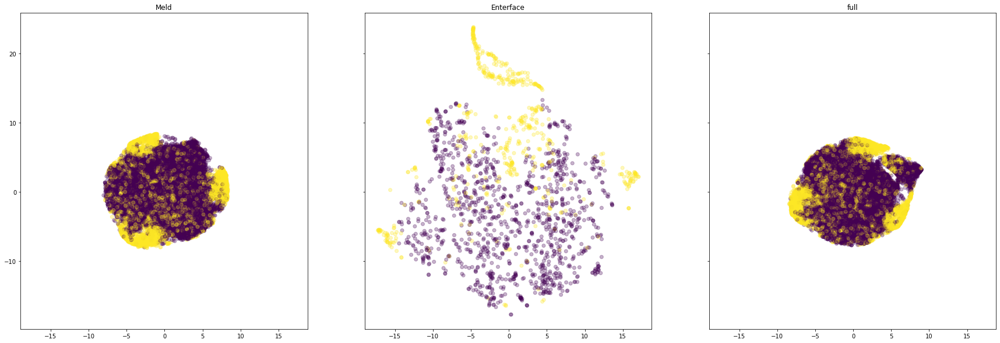

In [90]:
fig, axs = plt.subplots(1, 3, sharex=True, sharey=True, figsize = (30,10))
axs[0].scatter(tsne_results_Meld[:,0], tsne_results_Meld[:,1], c=Meld_Y, alpha=.3)
axs[0].set_title('Meld')
axs[1].scatter(tsne_results_Enterface[:,0], tsne_results_Enterface[:,1], c=Enterface_Y, alpha=.3)
axs[1].set_title('Enterface')
axs[2].scatter(tsne_results_full[:,0], tsne_results_full[:,1], c=full_Y, alpha=.3)
axs[2].set_title('full')

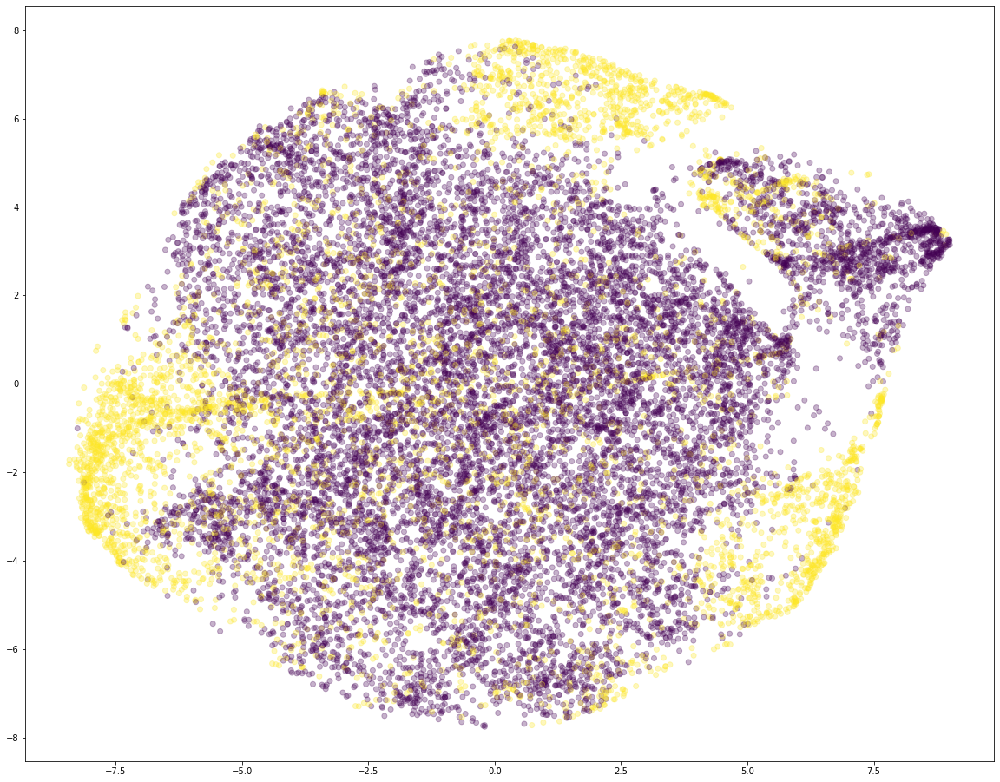

In [93]:
ax = plt.figure(figsize=(20,16))
plt.scatter(tsne_results_full[:,0], tsne_results_full[:,1], c=full_Y, alpha=.3)


In [106]:
full_X[0,:12]

array([-5.85978594e+00,  9.15742090e-01, -4.11431738e-01,  1.04386277e-01,
        9.12754692e-02, -1.62148391e-01,  5.72813867e-03, -3.71318087e-02,
        8.85159618e-03,  1.24219198e-01,  7.30975477e-02,  6.67113197e-02,
        7.71456152e-02,  1.06249345e-01,  1.52230923e-01,  1.48857359e-01,
        1.74169136e-01,  1.98064377e-01,  1.82352165e-01,  1.98012138e-01,
        2.17643384e-01,  2.01560870e-01,  1.94167172e-01,  1.87065174e-01,
        1.75345918e-01,  1.93674273e-01,  2.05157481e-01,  2.10600481e-01,
        2.38408830e-01,  2.42833760e-01,  2.16071783e-01,  1.88318706e-01,
        1.80675390e-01,  1.87867391e-01,  1.83076230e-01,  1.81680523e-01,
        1.73002344e-01,  1.47760409e-01,  1.49632469e-01,  1.68862592e-01,
        1.07025739e-03,  1.28624076e-03,  6.51914463e-04, -2.83326330e-05,
       -4.44516167e-04, -5.26121660e-04, -4.85547504e-04, -6.06971663e-04,
       -9.42321281e-04, -1.21816355e-03, -1.08660147e-03, -4.94712160e-04,
        2.10124106e-04,  

In [7]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_full = tsne.fit_transform(full_X[:,:40])


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 18208 samples in 0.002s...
[t-SNE] Computed neighbors for 18208 samples in 13.284s...
[t-SNE] Computed conditional probabilities for sample 1000 / 18208
[t-SNE] Computed conditional probabilities for sample 2000 / 18208
[t-SNE] Computed conditional probabilities for sample 3000 / 18208
[t-SNE] Computed conditional probabilities for sample 4000 / 18208
[t-SNE] Computed conditional probabilities for sample 5000 / 18208
[t-SNE] Computed conditional probabilities for sample 6000 / 18208
[t-SNE] Computed conditional probabilities for sample 7000 / 18208
[t-SNE] Computed conditional probabilities for sample 8000 / 18208
[t-SNE] Computed conditional probabilities for sample 9000 / 18208
[t-SNE] Computed conditional probabilities for sample 10000 / 18208
[t-SNE] Computed conditional probabilities for sample 11000 / 18208
[t-SNE] Computed conditional probabilities for sample 12000 / 18208
[t-SNE] Computed conditional probabilities for s

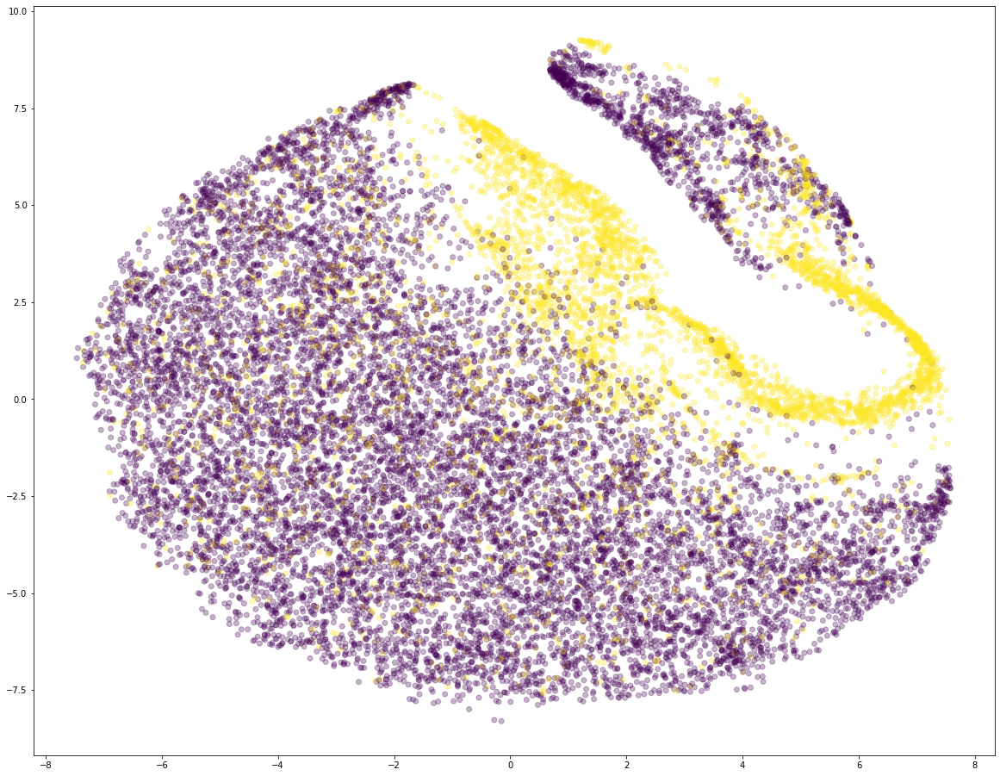

In [8]:
ax = plt.figure(figsize=(20,16))
plt.scatter(tsne_results_full[:,0], tsne_results_full[:,1], c=full_Y, alpha=.3)

In [9]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_full = tsne.fit_transform(full_X[:,:80])


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 18208 samples in 0.005s...
[t-SNE] Computed neighbors for 18208 samples in 14.673s...
[t-SNE] Computed conditional probabilities for sample 1000 / 18208
[t-SNE] Computed conditional probabilities for sample 2000 / 18208
[t-SNE] Computed conditional probabilities for sample 3000 / 18208
[t-SNE] Computed conditional probabilities for sample 4000 / 18208
[t-SNE] Computed conditional probabilities for sample 5000 / 18208
[t-SNE] Computed conditional probabilities for sample 6000 / 18208
[t-SNE] Computed conditional probabilities for sample 7000 / 18208
[t-SNE] Computed conditional probabilities for sample 8000 / 18208
[t-SNE] Computed conditional probabilities for sample 9000 / 18208
[t-SNE] Computed conditional probabilities for sample 10000 / 18208
[t-SNE] Computed conditional probabilities for sample 11000 / 18208
[t-SNE] Computed conditional probabilities for sample 12000 / 18208
[t-SNE] Computed conditional probabilities for s

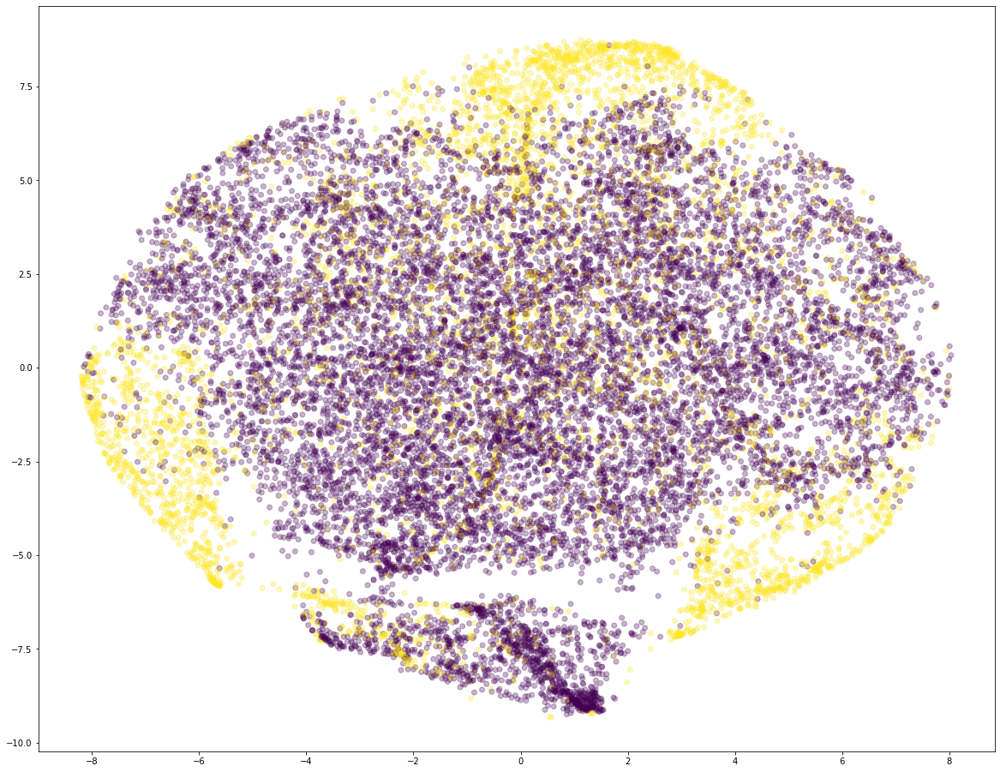

In [10]:
ax = plt.figure(figsize=(20,16))
plt.scatter(tsne_results_full[:,0], tsne_results_full[:,1], c=full_Y, alpha=.3)

In [11]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_full = tsne.fit_transform(full_X[:,40:80])

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 18208 samples in 0.002s...
[t-SNE] Computed neighbors for 18208 samples in 14.781s...
[t-SNE] Computed conditional probabilities for sample 1000 / 18208
[t-SNE] Computed conditional probabilities for sample 2000 / 18208
[t-SNE] Computed conditional probabilities for sample 3000 / 18208
[t-SNE] Computed conditional probabilities for sample 4000 / 18208
[t-SNE] Computed conditional probabilities for sample 5000 / 18208
[t-SNE] Computed conditional probabilities for sample 6000 / 18208
[t-SNE] Computed conditional probabilities for sample 7000 / 18208
[t-SNE] Computed conditional probabilities for sample 8000 / 18208
[t-SNE] Computed conditional probabilities for sample 9000 / 18208
[t-SNE] Computed conditional probabilities for sample 10000 / 18208
[t-SNE] Computed conditional probabilities for sample 11000 / 18208
[t-SNE] Computed conditional probabilities for sample 12000 / 18208
[t-SNE] Computed conditional probabilities for s

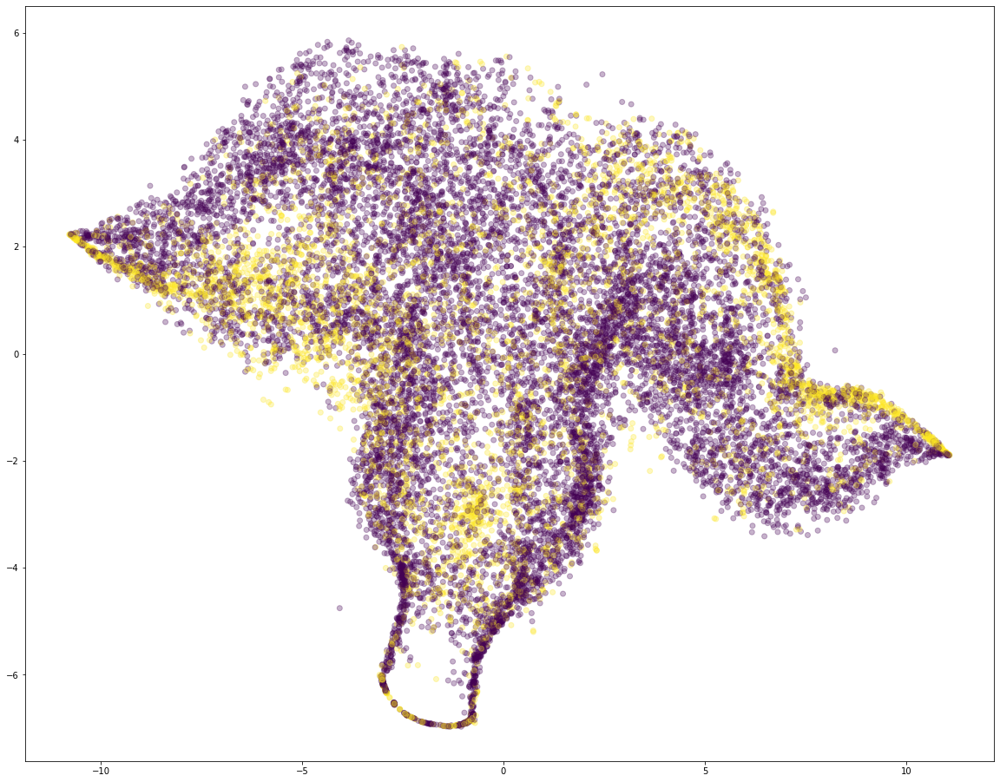

In [12]:
ax = plt.figure(figsize=(20,16))
plt.scatter(tsne_results_full[:,0], tsne_results_full[:,1], c=full_Y, alpha=.3)

In [13]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_full = tsne.fit_transform(full_X[:,80:])

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 18208 samples in 0.003s...
[t-SNE] Computed neighbors for 18208 samples in 15.094s...
[t-SNE] Computed conditional probabilities for sample 1000 / 18208
[t-SNE] Computed conditional probabilities for sample 2000 / 18208
[t-SNE] Computed conditional probabilities for sample 3000 / 18208
[t-SNE] Computed conditional probabilities for sample 4000 / 18208
[t-SNE] Computed conditional probabilities for sample 5000 / 18208
[t-SNE] Computed conditional probabilities for sample 6000 / 18208
[t-SNE] Computed conditional probabilities for sample 7000 / 18208
[t-SNE] Computed conditional probabilities for sample 8000 / 18208
[t-SNE] Computed conditional probabilities for sample 9000 / 18208
[t-SNE] Computed conditional probabilities for sample 10000 / 18208
[t-SNE] Computed conditional probabilities for sample 11000 / 18208
[t-SNE] Computed conditional probabilities for sample 12000 / 18208
[t-SNE] Computed conditional probabilities for s

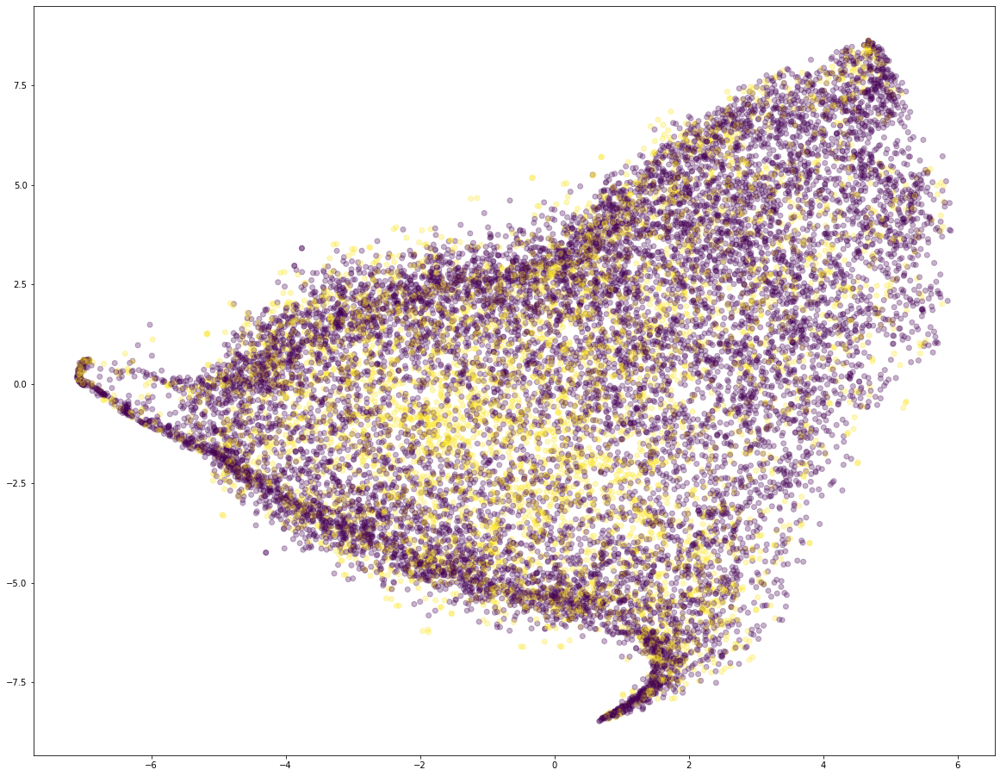

In [14]:
ax = plt.figure(figsize=(20,16))
plt.scatter(tsne_results_full[:,0], tsne_results_full[:,1], c=full_Y, alpha=.3)

In [15]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results_full = tsne.fit_transform(full_X[:,40:])

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 18208 samples in 0.003s...
[t-SNE] Computed neighbors for 18208 samples in 16.925s...
[t-SNE] Computed conditional probabilities for sample 1000 / 18208
[t-SNE] Computed conditional probabilities for sample 2000 / 18208
[t-SNE] Computed conditional probabilities for sample 3000 / 18208
[t-SNE] Computed conditional probabilities for sample 4000 / 18208
[t-SNE] Computed conditional probabilities for sample 5000 / 18208
[t-SNE] Computed conditional probabilities for sample 6000 / 18208
[t-SNE] Computed conditional probabilities for sample 7000 / 18208
[t-SNE] Computed conditional probabilities for sample 8000 / 18208
[t-SNE] Computed conditional probabilities for sample 9000 / 18208
[t-SNE] Computed conditional probabilities for sample 10000 / 18208
[t-SNE] Computed conditional probabilities for sample 11000 / 18208
[t-SNE] Computed conditional probabilities for sample 12000 / 18208
[t-SNE] Computed conditional probabilities for s

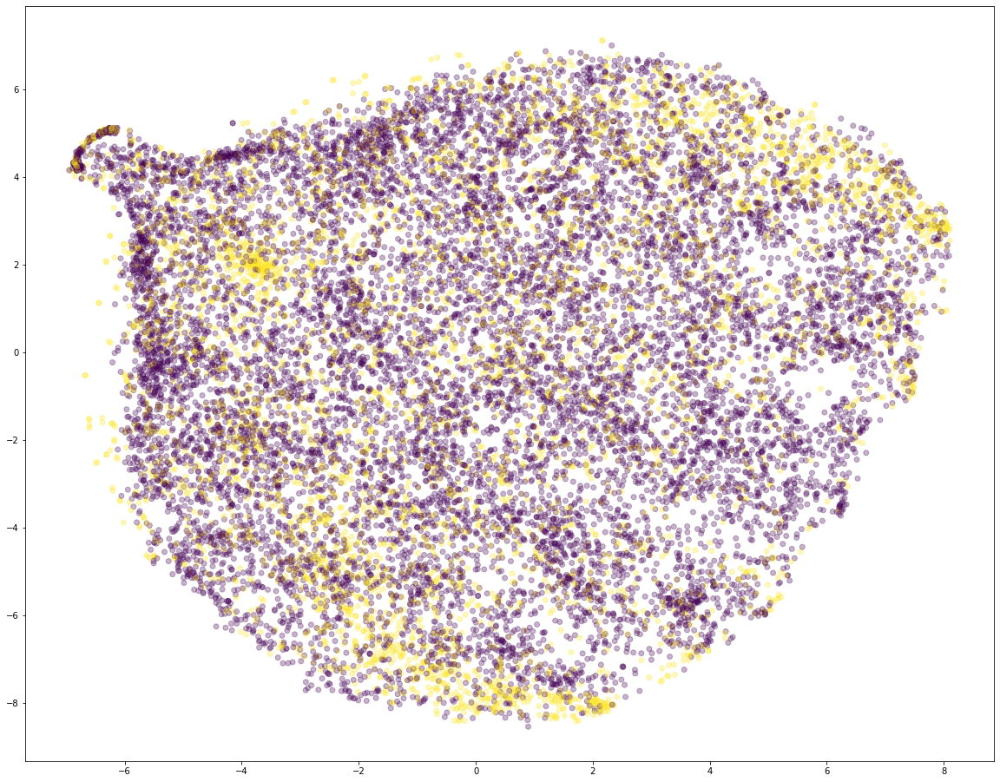

In [16]:
ax = plt.figure(figsize=(20,16))
plt.scatter(tsne_results_full[:,0], tsne_results_full[:,1], c=full_Y, alpha=.3)